<a href="https://colab.research.google.com/github/krithika-srinivasan/contemporary-romance-novels-gan/blob/main/romgan.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
%tensorflow_version 1.x

TensorFlow 1.x selected.


In [ ]:
!pip install torch==1.8.1 torchvision==0.9.1

     |████████████████████████████████| 804.1 MB 2.7 kB/s 
     |████████████████████████████████| 17.4 MB 129 kB/s 
  Attempting uninstall: torch
    Found existing installation: torch 1.9.0+cu111
    Uninstalling torch-1.9.0+cu111:
      Successfully uninstalled torch-1.9.0+cu111
  Attempting uninstall: torchvision
    Found existing installation: torchvision 0.10.0+cu111
    Uninstalling torchvision-0.10.0+cu111:
      Successfully uninstalled torchvision-0.10.0+cu111
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
torchtext 0.10.0 requires torch==1.9.0, but you have torch 1.8.1 which is incompatible.


In [ ]:
%mkdir images
%cd images

/content/images


In [ ]:
!wget -i /content/imgurls.txt
%cd ..

--2021-10-27 12:57:49--  https://i.gr-assets.com/images/S/compressed.photo.goodreads.com/books/1467138679l/25883848._SY475_.jpg
Resolving i.gr-assets.com (i.gr-assets.com)... 52.84.54.124
Connecting to i.gr-assets.com (i.gr-assets.com)|52.84.54.124|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 165698 (162K) [image/jpeg]
Saving to: ‘25883848._SY475_.jpg’

25883848._SY475_.jp 100%[===================>] 161.81K  --.-KB/s    in 0.02s   

2021-10-27 12:57:49 (7.12 MB/s) - ‘25883848._SY475_.jpg’ saved [165698/165698]

--2021-10-27 12:57:49--  https://i.gr-assets.com/images/S/compressed.photo.goodreads.com/books/1527983633l/36199084._SY475_.jpg
Reusing existing connection to i.gr-assets.com:443.
HTTP request sent, awaiting response... 200 OK
Length: 75418 (74K) [image/jpeg]
Saving to: ‘36199084._SY475_.jpg’

36199084._SY475_.jp 100%[===================>]  73.65K  --.-KB/s    in 0.003s  

2021-10-27 12:57:49 (26.3 MB/s) - ‘36199084._SY475_.jpg’ saved [75418/75418]



In [ ]:
!git clone https://github.com/NVlabs/stylegan2-ada-pytorch

Cloning into 'stylegan2-ada-pytorch'...
remote: Enumerating objects: 125, done.
remote: Counting objects: 100% (78/78), done.
remote: Compressing objects: 100% (39/39), done.
remote: Total 125 (delta 45), reused 39 (delta 39), pack-reused 47
Receiving objects: 100% (125/125), 1.12 MiB | 8.49 MiB/s, done.
Resolving deltas: 100% (56/56), done.


In [ ]:
%cd stylegan2-ada-pytorch

/content/stylegan2-ada-pytorch


In [ ]:
!python dataset_tool.py --source=/content/images/ --dest=/content/datasets/romnov.zip --transform=center-crop-wide --width=256 --height=256

100% 487/487 [00:12<00:00, 39.29it/s]


In [ ]:
!pip install ninja

     |████████████████████████████████| 108 kB 5.4 MB/s 


In [ ]:
!python train.py --outdir=/content/training-runs --data=/content/datasets/romnov.zip  --gpus=1 --dry-run
!python train.py --outdir=/content/training-runs --data=/content/datasets/romnov.zip  --gpus=1 --snap=1 --metrics=none --workers=2 


Training options:
{
  "num_gpus": 1,
  "image_snapshot_ticks": 1,
  "network_snapshot_ticks": 1,
  "metrics": [
    "fid50k_full"
  ],
  "random_seed": 0,
  "training_set_kwargs": {
    "class_name": "training.dataset.ImageFolderDataset",
    "path": "/content/datasets/romnov.zip",
    "use_labels": false,
    "max_size": 463,
    "xflip": false,
    "resolution": 256
  },
  "data_loader_kwargs": {
    "pin_memory": true,
    "num_workers": 2,
    "prefetch_factor": 2
  },
  "G_kwargs": {
    "class_name": "training.networks.Generator",
    "z_dim": 512,
    "w_dim": 512,
    "mapping_kwargs": {
      "num_layers": 2
    },
    "synthesis_kwargs": {
      "channel_base": 16384,
      "channel_max": 512,
      "num_fp16_res": 4,
      "conv_clamp": 256
    }
  },
  "D_kwargs": {
    "class_name": "training.networks.Discriminator",
    "block_kwargs": {},
    "mapping_kwargs": {},
    "epilogue_kwargs": {
      "mbstd_group_size": 4
    },
    "channel_base": 16384,
    "channel_max": 5

In [ ]:
!python train.py --outdir=/content/training-runs --data=/content/dataset/  --gpus=1 --resume=/content/training-runs/00005--auto1-resumecustom/network-snapshot-000000.pkl


Training options:
{
  "num_gpus": 1,
  "image_snapshot_ticks": 50,
  "network_snapshot_ticks": 50,
  "metrics": [
    "fid50k_full"
  ],
  "random_seed": 0,
  "training_set_kwargs": {
    "class_name": "training.dataset.ImageFolderDataset",
    "path": "/content/dataset/",
    "use_labels": false,
    "max_size": 997,
    "xflip": false,
    "resolution": 256
  },
  "data_loader_kwargs": {
    "pin_memory": true,
    "num_workers": 3,
    "prefetch_factor": 2
  },
  "G_kwargs": {
    "class_name": "training.networks.Generator",
    "z_dim": 512,
    "w_dim": 512,
    "mapping_kwargs": {
      "num_layers": 2
    },
    "synthesis_kwargs": {
      "channel_base": 16384,
      "channel_max": 512,
      "num_fp16_res": 4,
      "conv_clamp": 256
    }
  },
  "D_kwargs": {
    "class_name": "training.networks.Discriminator",
    "block_kwargs": {},
    "mapping_kwargs": {},
    "epilogue_kwargs": {
      "mbstd_group_size": 4
    },
    "channel_base": 16384,
    "channel_max": 512,
    "

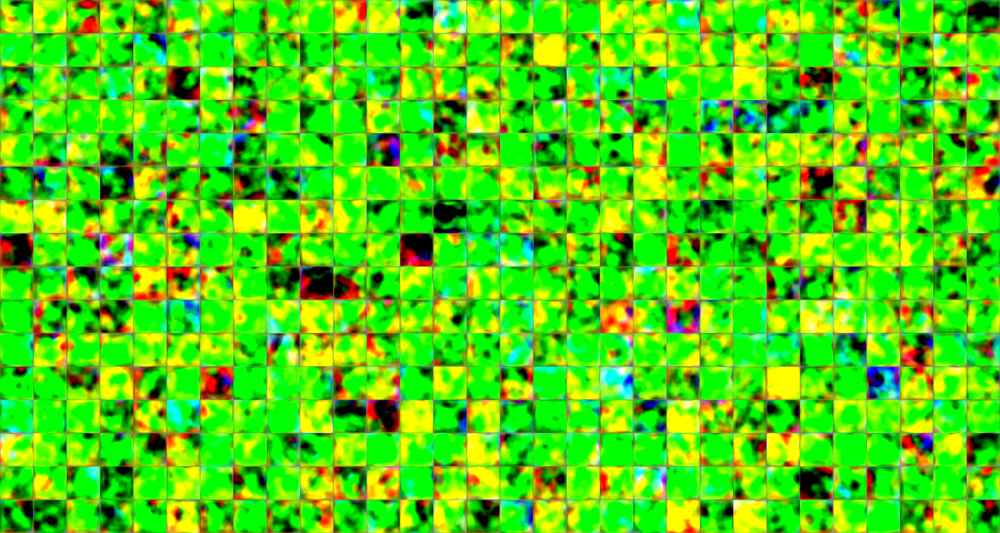

In [ ]:
from IPython.display import Image
Image("/content/training-runs/00002--auto1-resumecustom/fakes000000.png")